<a href="https://colab.research.google.com/github/victormota47/Calculo-de-IMC/blob/main/PROVASandro_OFC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Iniciando o processamento de 4 imagens...
--- Processando: pexels-mikebirdy-116675.jpg ---
  -> Detectado: OUTROS_VEICULOS. Salvo em: OUTROS_VEICULOS/car_1.jpg

Visualização das Detecções:


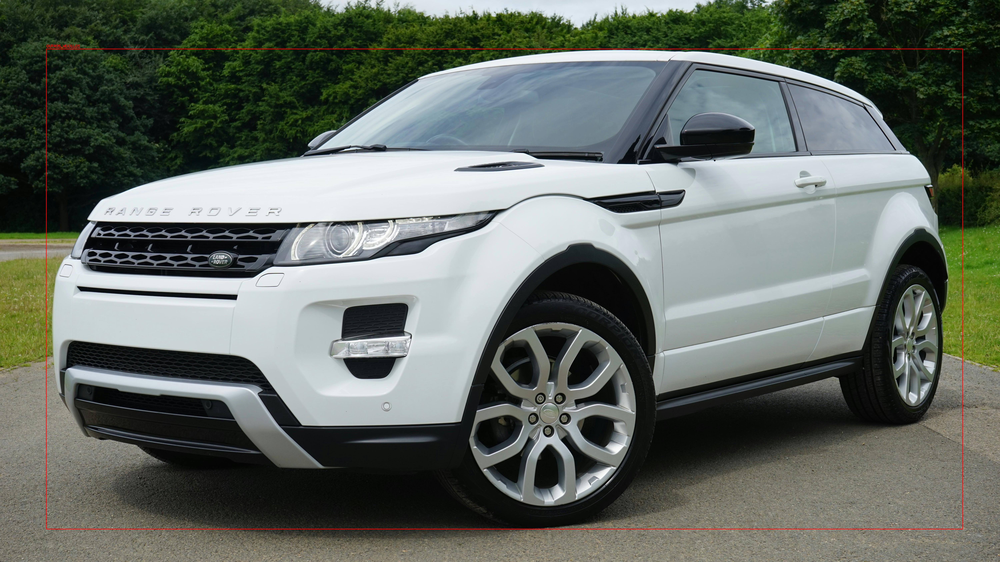

------------------------------------------
--- Processando: pngtree-d-rendering-of-a-white-background-with-a-blue-super-sports-image_3846375.jpg ---
  -> Detectado: MOTO_COR_AZUL. Salvo em: MOTO_COR_AZUL/motorcycle_2.jpg

Visualização das Detecções:


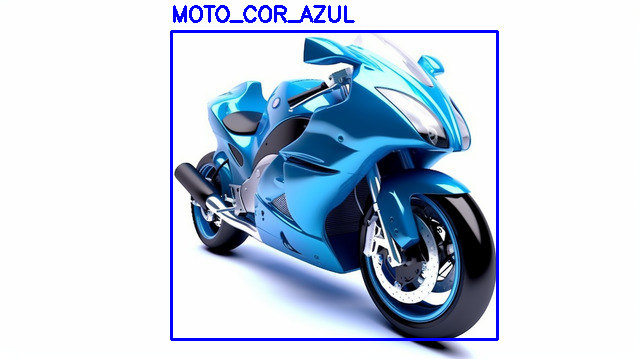

------------------------------------------
--- Processando: moto-4860362_1280-removebg-preview.png ---

Visualização das Detecções:


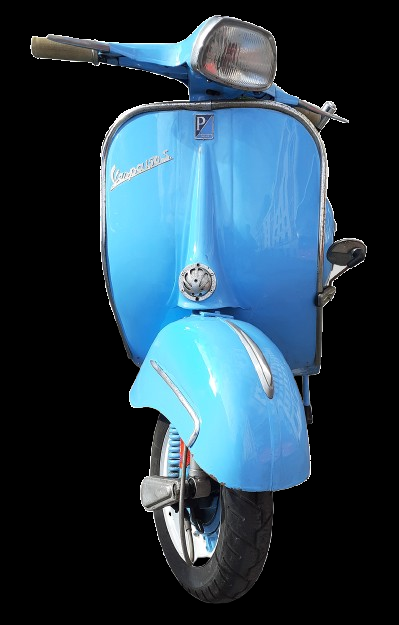

------------------------------------------
--- Processando: pexels-micah-boerma-327482-1008738-removebg-preview.png ---
  -> Detectado: OUTROS_VEICULOS. Salvo em: OUTROS_VEICULOS/truck_3.jpg

Visualização das Detecções:


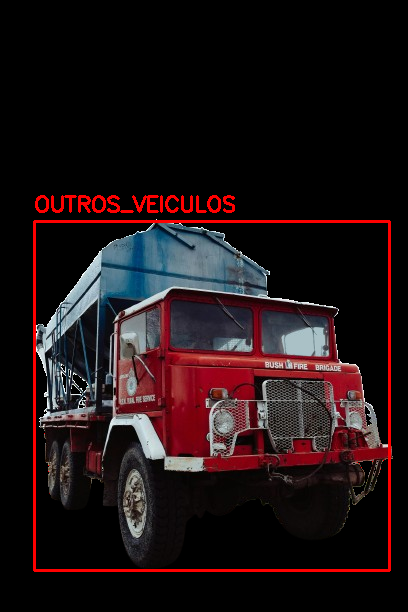

------------------------------------------

--- PROCESSAMENTO CONCLUÍDO ---
Total de veículos processados: 3
--- RESULTADOS POR PASTA ---
MOTO NA COR AZUL: 1
MOTOS DE OUTRAS CORES: 0
OUTROS VEICULOS: 2


In [66]:
import cv2
import numpy as np
import os
from ultralytics import YOLO
import glob
from google.colab.patches import cv2_imshow # Import necessário para exibir imagens no Colab

# --- 1. CONFIGURAÇÃO ---

# Carregar o modelo YOLOv8 pré-treinado
# Será baixado automaticamente na primeira execução
model = YOLO('yolov8n.pt')

# Mapeamento dos nomes de classes do modelo COCO
CLASSES = model.names
MOTORCYCLE_CLASS_ID = 3 # ID para 'motorcycle' (moto)

# Pastas (CORRIGIDO PARA O PORTUGUÊS DO SEU PEDIDO)
INPUT_DIR = "imagens_entrada"
OUTPUT_DIRS = {
    "moto_azul": "MOTO_COR_AZUL",
    "moto_outras": "MOTOS_OUTRAS_CORES",
    "nao_moto": "OUTROS_VEICULOS"
}

# Criar as pastas de saída se não existirem
for d in OUTPUT_DIRS.values():
    os.makedirs(d, exist_ok=True)
os.makedirs(INPUT_DIR, exist_ok=True) # Certifica que a pasta de entrada existe

# Definir o intervalo de cor AZUL no espaço de cores HSV
# Ajuste estes valores se a detecção de azul não estiver precisa
LOWER_BLUE = np.array([90, 50, 50])
UPPER_BLUE = np.array([130, 255, 255])
BLUE_THRESHOLD_PERCENT = 30 # Limiar mínimo de pixels azuis (30%)


# --- 2. FUNÇÕES DE APOIO ---

def is_blue(cropped_image, display_mask=False):
    """
    Verifica se a cor dominante na imagem recortada é azul.
    """
    if cropped_image.size == 0:
        return False

    # Converter para o espaço de cores HSV
    hsv = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2HSV)
    # Criar a máscara com o intervalo de azul
    mask = cv2.inRange(hsv, LOWER_BLUE, UPPER_BLUE)

    if display_mask:
        # Mostra a máscara azul detectada (útil para debug)
        print("Máscara Azul (Pixel Branco = Azul Detectado):")
        cv2_imshow(mask)

    blue_pixels = np.sum(mask > 0)
    total_pixels = cropped_image.shape[0] * cropped_image.shape[1]

    if total_pixels == 0:
        return False

    blue_percentage = (blue_pixels / total_pixels) * 100

    return blue_percentage > BLUE_THRESHOLD_PERCENT

def process_image(image_path, total_processed_count):
    """
    Processa uma única imagem, detecta veículos e os classifica, salvando os recortes.
    """
    frame = cv2.imread(image_path)
    if frame is None:
        print(f"ERRO: Não foi possível ler a imagem {image_path}")
        return total_processed_count

    print(f"--- Processando: {os.path.basename(image_path)} ---")

    # Executar a detecção YOLOv8
    results = model(frame, verbose=False, classes=[2, 3, 5, 7])

    # Criar uma cópia para visualização
    frame_display = frame.copy()

    # Iterar sobre as detecções
    for r in results:
        boxes = r.boxes
        for box in boxes:
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().astype(int)
            cls_id = int(box.cls[0].cpu().numpy())
            label = CLASSES[cls_id]

            # Recortar o veículo
            cropped_vehicle = frame[y1:y2, x1:x2]

            # Classificação
            if cls_id == MOTORCYCLE_CLASS_ID:
                # Análise de Cor (Apenas para Motos)
                if is_blue(cropped_vehicle):
                    classification_key = "moto_azul"
                    color_box = (255, 0, 0) # Azul para MOTO AZUL
                else:
                    classification_key = "moto_outras"
                    color_box = (0, 255, 0) # Verde para MOTOS OUTRAS CORES

                # Save motorcycles (blue or other colors)
                total_processed_count += 1
                dir_name = OUTPUT_DIRS[classification_key]
                filename = f"{label}_{total_processed_count}.jpg"
                save_path = os.path.join(dir_name, filename)
                cv2.imwrite(save_path, cropped_vehicle)
                print(f"  -> Detectado: {dir_name}. Salvo em: {save_path}")

                # Draw the rectangle and text on the display image
                cv2.rectangle(frame_display, (x1, y1), (x2, y2), color_box, 2)
                display_text = dir_name
                cv2.putText(frame_display, display_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color_box, 2)


            else:
                # This is not a motorcycle, save to "OUTROS_VEICULOS"
                classification_key = "nao_moto"
                color_box = (0, 0, 255) # Vermelho para OUTROS VEÍCULOS

                total_processed_count += 1
                dir_name = OUTPUT_DIRS[classification_key]
                filename = f"{label}_{total_processed_count}.jpg"
                save_path = os.path.join(dir_name, filename)
                cv2.imwrite(save_path, cropped_vehicle)
                print(f"  -> Detectado: {dir_name}. Salvo em: {save_path}")

                # Draw the rectangle and text on the display image
                cv2.rectangle(frame_display, (x1, y1), (x2, y2), color_box, 2)
                display_text = dir_name
                cv2.putText(frame_display, display_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, color_box, 2)


    # Exibir a imagem original com as caixas de detecção no Colab
    print("\nVisualização das Detecções:")
    cv2_imshow(frame_display)
    print("------------------------------------------")

    return total_processed_count

# --- 3. EXECUÇÃO PRINCIPAL ---

def main_static():
    """
    Loop principal para processar todas as imagens na pasta de entrada.
    """

    # Busca por imagens comuns (jpg, png) na pasta de entrada
    image_paths = glob.glob(os.path.join(INPUT_DIR, '*.jpg'))
    image_paths.extend(glob.glob(os.path.join(INPUT_DIR, '*.png')))
    image_paths.extend(glob.glob(os.path.join(INPUT_DIR, '*.jpeg')))

    if not image_paths:
        print(f"\n--- ERRO ---\nNão foram encontradas imagens (.jpg, .png, .jpeg) na pasta '{INPUT_DIR}'.")
        print("1. Crie a pasta 'imagens_entrada' na sessão do Colab.")
        print("2. Faça o upload das suas imagens para essa pasta.")
        return

    print(f"Iniciando o processamento de {len(image_paths)} imagens...")

    total_vehicles_processed = 0

    # Clear output directories before processing
    for d in OUTPUT_DIRS.values():
        files = glob.glob(os.path.join(d, '*'))
        for f in files:
            os.remove(f)

    for path in image_paths:
        total_vehicles_processed = process_image(path, total_vehicles_processed)

    # Contagem final
    final_counts = {v: len(os.listdir(v)) for v in OUTPUT_DIRS.values()}

    print("\n============================================")
    print("--- PROCESSAMENTO CONCLUÍDO ---")
    print(f"Total de veículos processados: {total_vehicles_processed}")
    print("--- RESULTADOS POR PASTA ---")
    print(f"MOTO NA COR AZUL: {final_counts['MOTO_COR_AZUL']}")
    print(f"MOTOS DE OUTRAS CORES: {final_counts['MOTOS_OUTRAS_CORES']}")
    print(f"OUTROS VEICULOS: {final_counts['OUTROS_VEICULOS']}")
    print("============================================")

if __name__ == "__main__":
    # Garante que a função principal seja chamada para iniciar o processamento
    main_static()